# Exploratory Data Analysis

Visualize and understand season's data to see where team ranks in offensive and defensive measures.

In [1]:
#modules
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns 
import statsmodels.graphics.api as smg
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

%matplotlib inline

In [2]:
#get finals data for players and coaches
players = pd.read_csv('players_trim.csv', index_col='Unnamed: 0').reset_index(drop=True)
coaches = pd.read_csv('coaches.csv', index_col='Unnamed: 0').reset_index(drop=True)
print('players:', players.shape)
print('coaches:', coaches.shape)

#separate finals data for later
player_finals = players[(players['Champ']==1) | (players['Runner-Up']==1)]
coach_finals = coaches[(coaches['Champ']==1) | (coaches['Runner-Up']==1)]
print('\nplayers finals:', player_finals.shape)
print('coaches finals:', coach_finals.shape)

#features for each table
print('\nPlayer features:\n', player_finals.columns.values)
print('\nCoach features:\n', coach_finals.columns.values)

players: (6076, 32)
coaches: (332, 26)

players finals: (352, 32)
coaches finals: (21, 26)

Player features:
 ['Player' 'Pos' 'Age' 'Tm' 'G' 'GS' 'MP' 'FG' 'FGA' 'FG%' '3P' '3PA' '3P%'
 '2P' '2PA' '2P%' 'eFG%' 'FT' 'FTA' 'FT%' 'ORB' 'DRB' 'TRB' 'AST' 'STL'
 'BLK' 'TOV' 'PF' 'PTS' 'Year' 'Champ' 'Runner-Up']

Coach features:
 ['Coach' 'Team' 'F-Seasons' 'Car-Seasons' 'CR-G' 'CR-W' 'CR-L' 'FR-G'
 'FR-W' 'FR-L' 'Car-G' 'Car-W' 'Car-L' 'Car-W%' 'CP-G' 'CP-W' 'CP-L'
 'FP-G' 'FP-W' 'FP-L' 'Car.P-G' 'Car.P-W' 'Car.P-L' 'Year' 'Champ'
 'Runner-Up']


## Players EDA
Starting with categorical features review

In [3]:
#split features
player_num_features = ['Age', 'G', 'GS', 'MP', 'FG', 'FGA', 'FG%', '3P', '3PA', '3P%', '2P', '2PA', '2P%', 'eFG%', 'FT', 'FTA', 'FT%', 'ORB', 'DRB', 'TRB', 'AST', 'STL', 'BLK', 'TOV', 'PF', 'PTS']
player_cat_features = ['Player', 'Pos', 'Tm', 'Year', 'Champ', 'Runner-Up']

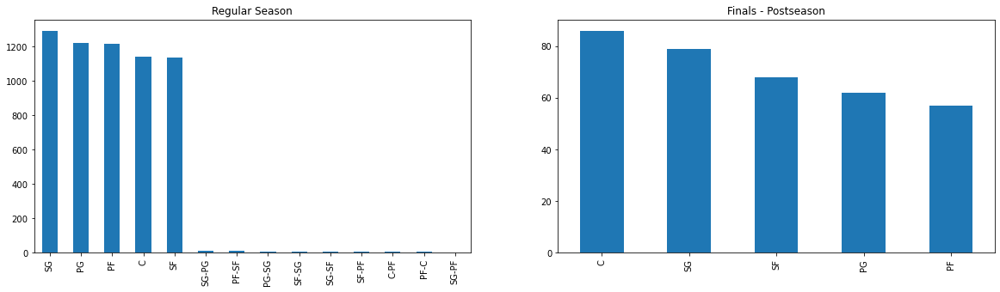

In [4]:
#position distribution
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(20,5))
pd.value_counts(players['Pos']).plot.bar(ax=ax1)
pd.value_counts(player_finals['Pos']).plot.bar(ax=ax2)
ax1.set_title('Regular Season')
ax2.set_title('Finals - Postseason')
plt.show()

### Player Positions:  
In the regular seasons, positions are more interchangeable. To make further analysis more feasible, these will be placed as frontcourt (FC) and backcourt (BC) players:
- BC = SG, PG combinations
- FC = SF, PF, C combinations

### Ambigious Positions:
- If a player falls under both, their post-season position or listed position over their career will be used.
- We examine them below to see what they are most identifiable as by position. It is most likely top stars who are known to handle multiple team roles because of their many capabilities e.g. Lebron James

In [14]:
df_other_positions = players[(players['Pos']=='SG-SF') | (players['Pos']=='SF-SG') | (players['Pos']=='SG-PF')]
df_other_positions.describe()

,Age,G,GS,MP,FG,FGA,FG%,3P,3PA,3P%,...,TRB,AST,STL,BLK,TOV,PF,PTS,Year,Champ,Runner-Up
count,20.000000,20.00000,20.000000,20.000000,20.000000,20.000000,20.000000,20.000000,20.000000,20.000000,...,20.000000,20.000000,20.000000,20.000000,20.000000,20.000000,20.000000,20.000000,20.0,20.0
mean,28.100000,55.45000,21.700000,19.980000,2.730000,6.550000,0.408800,0.835000,2.410000,0.323750,...,2.480000,1.470000,0.710000,0.240000,0.985000,1.640000,7.620000,2014.050000,0.0,0.0
std,4.024922,19.48677,27.247598,9.139365,1.902104,4.283444,0.039665,0.639305,1.591061,0.069338,...,1.424079,1.045844,0.529051,0.187504,0.724224,0.630288,5.431448,3.605186,0.0,0.0
min,21.000000,7.00000,0.000000,7.500000,0.700000,1.900000,0.344000,0.100000,0.400000,0.182000,...,0.900000,0.200000,0.200000,0.000000,0.100000,0.400000,1.800000,2010.000000,0.0,0.0
25%,25.750000,42.00000,2.000000,11.675000,1.525000,4.100000,0.386500,0.375000,1.375000,0.268750,...,1.750000,0.825000,0.300000,0.100000,0.600000,1.250000,3.950000,2010.750000,0.0,0.0
50%,28.500000,57.50000,8.500000,19.050000,2.200000,5.650000,0.401500,0.550000,1.950000,0.348500,...,2.250000,1.150000,0.500000,0.200000,0.750000,1.650000,6.000000,2013.500000,0.0,0.0
75%,31.000000,70.50000,25.500000,22.550000,3.025000,6.950000,0.424250,1.250000,3.300000,0.373250,...,2.525000,2.100000,0.875000,0.300000,1.300000,2.075000,8.800000,2018.000000,0.0,0.0
max,37.000000,81.00000,81.000000,38.600000,7.400000,17.500000,0.517000,2.200000,5.800000,0.431000,...,6.200000,4.000000,1.900000,0.700000,3.200000,2.600000,20.600000,2019.000000,0.0,0.0


In [15]:
#Position assignments to see what is prominent
df_other_positions.Pos.value_counts()

SF-SG    9
SG-SF    9
SG-PF    2
Name: Pos, dtype: int64

In [16]:
#see what the short hand means. Does the first position indicate the usual position or vice versa for each player?
df_other_positions[['Player', 'Pos']]

,Player,Pos
86,Caron Butler,SF-SG
280,Stephen Jackson,SG-PF
309,Coby Karl,SF-SG
461,Quinton Ross,SF-SG
532,Henry Walker,SG-SF
659,Corey Brewer,SF-SG
1015,Sasha Pavlović,SG-SF
1026,Mickaël Piétrus,SG-SF
1761,James Anderson,SG-SF
1913,Francisco García,SG-SF


Something interesting to note about these players. They never made it to the finals, so the theory about them being great players is not true because most of the great players of this generation have at least made it to the finals or the playoffs. Next we see the distribution of these 20 players across ten years.

**Distribution:** Given that most of the players are in the SG/SF combination, we checked to see if the order in which the position was tagged gives insight into the player's usual position. This didn't really help because if we look at two examples:
- Corey Brewer is a SF -> listed as SF-SG twice, and
- Kyle Korver is a SG -> listed as SG-PF BUT
- Jimmy Butler and Stephen Jackson are SG/SF really and listed as such or in SJ case, SG-PF.

### Positions Decision
Given this, I have decided to use the first listed position for each player to indicate where they fall in the front or back court. It could be argued that most SF nowadays shoot more than they defend so they are defacto FC players. However, we are going to leave these distinctions so that we can observe if any of the offense parameters change overt time for these types of players. Additionally, since it is only 20/6000+, this should not affect the statistical significance of any decisions hereafter.

In [17]:
#method for adding new front court and back court designation for all players
def player_positions(pos):
    if pos in ['SG', 'PG', 'SG-PG', 'PG-SG']:
        return 'BC'
    elif pos in ['PF', 'SF', 'C', 'C-PF', 'PF-C', 'SF-PF', 'PF-SF']:
        return 'FC'
    else:
        return player_positions(pos[0:2])


In [18]:
#create new column and append to dataframe
players['Court_Pos'] = players['Pos'].apply(lambda x: player_positions(x))

In [19]:
#preview of updated dataframe
players.head()

,Player,Pos,Age,Tm,G,GS,MP,FG,FGA,FG%,...,AST,STL,BLK,TOV,PF,PTS,Year,Champ,Runner-Up,Court_Pos
0,Arron Afflalo,SG,24.0,DEN,82.0,75.0,27.1,3.3,7.1,0.465,...,1.7,0.6,0.4,0.9,2.7,8.8,2010,0,0,BC
1,Alexis Ajinça,C,21.0,CHA,6.0,0.0,5.0,0.8,1.7,0.500,...,0.0,0.2,0.2,0.3,0.8,1.7,2010,0,0,FC
2,LaMarcus Aldridge,PF,24.0,POR,78.0,78.0,37.5,7.4,15.0,0.495,...,2.1,0.9,0.6,1.3,3.0,17.9,2010,0,0,FC
3,Joe Alexander,SF,23.0,CHI,8.0,0.0,3.6,0.1,0.8,0.167,...,0.3,0.1,0.1,0.0,1.1,0.5,2010,0,0,FC
4,Malik Allen,PF,31.0,DEN,51.0,3.0,8.9,0.9,2.3,0.397,...,0.3,0.2,0.1,0.4,1.3,2.1,2010,0,0,FC


In [20]:
#resaving a copy for the next steps
players.to_csv('players_trim.csv')
#reset player_finals table segment
player_finals = players[(players['Champ']==1) | (players['Runner-Up']==1)]
#dataframe copy for manipulation
df_player = players.copy()
df_coach = coaches.copy()

#features of finals players
player_finals[player_num_features].describe()

,Age,G,GS,MP,FG,FGA,FG%,3P,3PA,3P%,...,FT%,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS
count,352.000000,352.000000,352.000000,352.000000,352.000000,352.000000,352.000000,352.000000,352.000000,299.000000,...,340.000000,352.000000,352.000000,352.000000,352.000000,352.000000,352.000000,352.000000,352.000000,352.000000
mean,28.278409,49.872159,22.840909,19.074148,3.016193,6.379830,0.460199,0.731534,1.964205,0.310388,...,0.738512,0.780398,2.628125,3.403977,1.809375,0.603693,0.438920,1.082386,1.631250,8.080398
std,4.436547,25.533133,29.009532,9.807006,2.459737,4.882035,0.089763,0.860994,2.101396,0.159383,...,0.149785,0.686323,1.894009,2.415604,1.887233,0.467597,0.546047,0.839466,0.725239,6.774398
min,19.000000,1.000000,0.000000,2.600000,0.000000,0.400000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,25.000000,26.000000,0.750000,10.400000,1.275000,2.900000,0.414000,0.000000,0.100000,0.268500,...,0.658500,0.300000,1.300000,1.700000,0.500000,0.300000,0.100000,0.500000,1.100000,3.375000
50%,28.000000,57.000000,6.000000,18.250000,2.300000,4.900000,0.463000,0.500000,1.500000,0.351000,...,0.765000,0.600000,2.100000,2.650000,1.200000,0.500000,0.300000,0.800000,1.600000,5.950000
75%,32.000000,73.000000,50.250000,26.950000,3.800000,8.200000,0.514250,1.100000,3.100000,0.400500,...,0.837500,1.100000,3.400000,4.400000,2.300000,0.800000,0.600000,1.500000,2.100000,10.225000
max,39.000000,82.000000,82.000000,42.000000,10.500000,21.500000,0.800000,5.100000,11.700000,1.000000,...,1.000000,4.000000,8.600000,11.300000,9.800000,2.300000,6.000000,4.200000,6.000000,30.100000


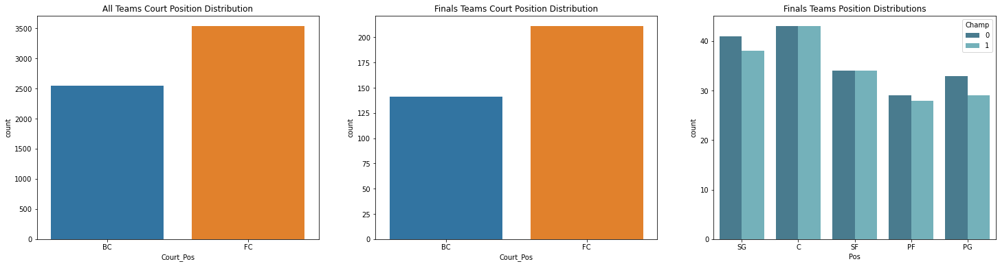

In [21]:
#Positions and teams with champions/runner up
fig, (ax1, ax2, ax3) = plt.subplots(ncols=3, figsize=(25,6))
sns.countplot(df_player['Court_Pos'], ax=ax1)
sns.countplot(df_player[(df_player['Champ']==1) | (df_player['Runner-Up']==1)]['Court_Pos'], ax=ax2)
sns.countplot(x='Pos', hue='Champ', 
              data=df_player[(df_player['Champ']==1) | (df_player['Runner-Up']==1)],                              palette='GnBu_d', ax=ax3)
ax1.set_title('All Teams Court Position Distribution')
ax2.set_title('Finals Teams Court Position Distribution')
ax3.set_title('Finals Teams Position Distributions')
plt.show()

As expected, there are more front court players. On the court 3/5 are front court. However looking at the teams in the finals, there seems to be more guards getting playing time overall. And the finals teams are mostly evenly matched in front court positions, but outnumbered on the backcourt (SG and PG)

***My initial assumption*** was that we would have five unique values (PG, SG, SF, PF, C). However, there are players that play multiple roles consistently throughout the season. Given this, I'm going to add a class for whether it is a frontcourt or backcourt player. There is still the issue of intersections as we have players in the SF-SG and SG-PF bars.

**Decision so far:** Data exploration focused on just the finals teams for the last ten years below continues.

## Finals teams

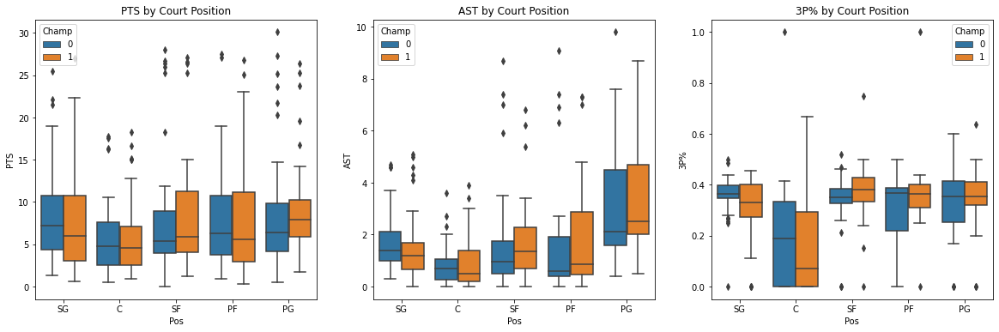

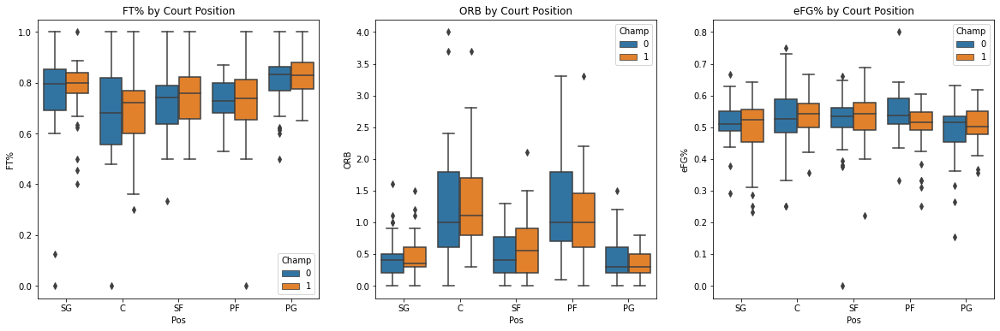

In [22]:
#plot for finals /there has to be a cleaner way but for now

# We don't need to use B/FC designations yet because we didn't have intersections in the finals data
offense = ['PTS', 'AST', '3P%', 'FT%', 'ORB', 'eFG%']
#first three variables
fig1, ([ax1, ax2, ax3]) = plt.subplots(ncols=3, figsize=(20,6))
for i, a in zip(offense[0:3], [ax1, ax2, ax3]):
    a.set_title(i+' by Court Position')
    sns.boxplot(x='Pos', y=i, data=player_finals, hue='Champ', ax=a)
#next three variables
fig2, ([ax1, ax2, ax3]) = plt.subplots(ncols=3, figsize=(20,6))
for i, a in zip(offense[3:6], [ax1, ax2, ax3]):
    a.set_title(i+' by Court Position')
    sns.boxplot(x='Pos', y=i, data=player_finals, hue='Champ', ax=a)
plt.show()

## Offense observations:
**Points, Assists, and Efficiency** 

For every position except that of the point guard, the finals teams have a variety of scoring with more high scorers throughout the season. They also have and edge for three positions with assists. There is not much of a difference in impact on the higher end of free throw shooting. However, their better performing shooters are at least the same, or better than the rest of the league. This is more apparent in the center and small forward positions. Similar observations can be made in evaluating the effective field goal percentage where only point guards and power forwards in the finals tend to have less above average statistics than their non-champion counterparts throughout the season.

**Offensive Rebounds**

Winning teams are good at creating second chances as they have the best offensive rebounders at the forward positions and are on par at all but the shooting guard offensive rebounding position.


In [ ]:
defense = ['STL', 'BLK', 'TRB', 'TOV']
fig, ([ax1, ax2, ax3, ax4]) = plt.subplots(ncols=4, figsize=(20,5))
for d, a in zip(defense, [ax1, ax2, ax3, ax4]):
    a.set_title(d+' by Position')
    sns.boxplot(x='Pos', y=d, data=player_finals, hue='Champ', ax=a)
plt.show()

## Defense observations:
- For all positions, championship teams have more and (more players) with ***steals***
- Although the backcourt is outpaced for **blocks**, the frontcourt more than makes up for it to give the championship team more blocks that its opponent
- ***Total rebounds*** are only a difference maker when the switchable shooting guard and small forward position players are dominant. The runner-up seems to average more total rebounds.
- The winning team has an edge on possessions as their players tend to have on average, less turnovers, especially for the positions that are more likely ball-handlers (guards).


## Distributions:
Looking at the variables' distributions and correlations

### Correlations between important features
Trying to decipher what is strongly correlated with wins and losses or winning a championship in this case using the features that are most identifiable as offensive and defensive measures. Instead of using FG% AND 3FG%, we will use the effective field goal percentage which accounts for a three pointer being worth more points than a two pointer (eFG%). Also adding turnovers to see how well the team's possession of the ball affects the other measures

In [24]:
game_measures = ['PTS', 'AST', 'ORB', 'eFG%','STL', 'BLK', 'TRB', 'TOV', 'Champ']

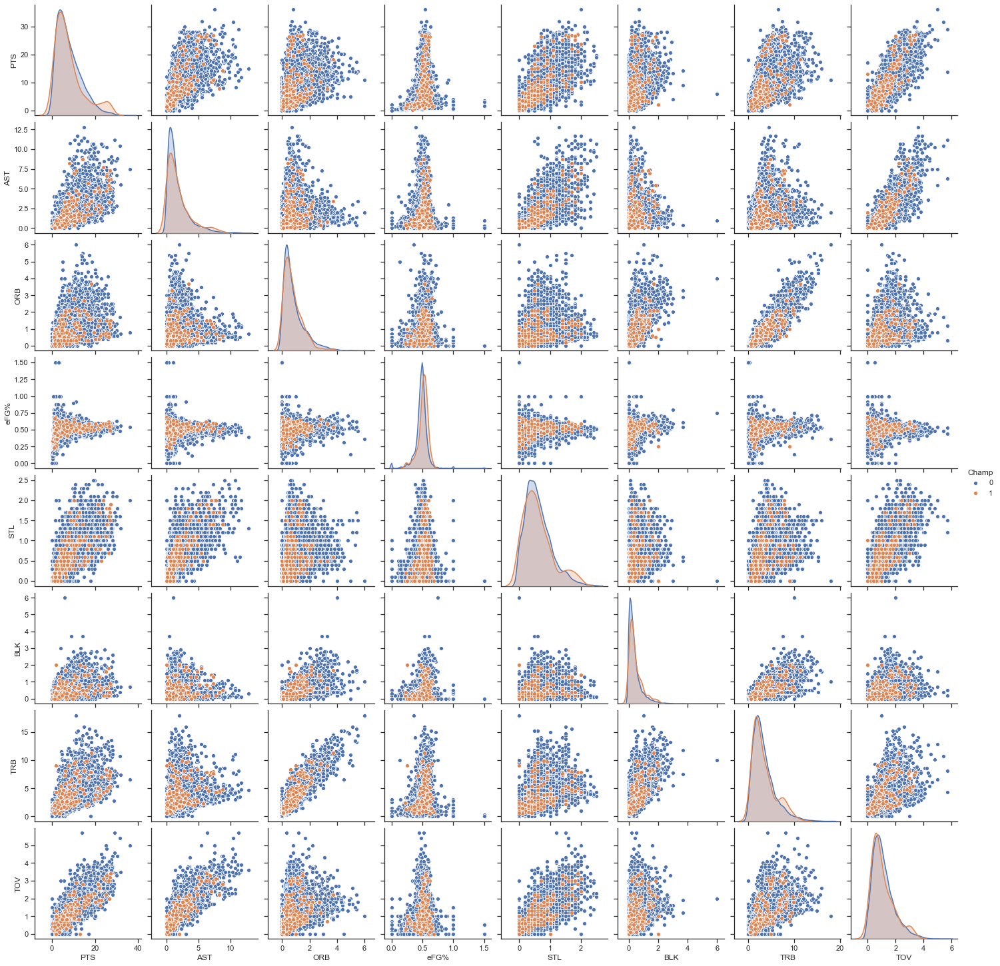

In [16]:
#correlation plot of main measures
sns.set(style='ticks', color_codes=True)
sns.pairplot(players[game_measures], hue='Champ')
plt.show()

### Distribution observations
Most of the distributions are right skewed. eFG% is not quite normal, but is highly concentrated at particular values

### Correlation observations
It seems when teams make it to the finals, they are mostly evenly matched in terms of scoring and defense measures. May be helpful to:
- Review all the teams and compare them to those that won
- Another approach would be to review the teams that made it to the playoffs against those that went to the finals
- A new feature that could be introduced is the number of years of experience for each player in the finals to see how this factors into performance

**Decision:** Adding years of experience feature for each player that made it to the finals. This will be done on the data wrangling file.

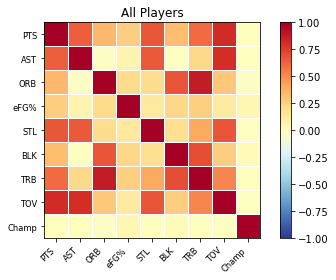

In [25]:
#correlation matrix for all teams vs finals teams
smg.plot_corr(df_player[game_measures].corr(), xnames=game_measures, normcolor=(-1,1), title='All Players')
plt.show()

Based on comparison for all teams (regular/playoff season and finals teams), the following observations can be made:
- Turnovers for a player are highly correlated with the steals and total rebounds on the defensive side
- Turnovers also have a high correlation with points and assists for the player on the offensive side of the ball
- This may infer that the person who touches the ball the most will have the highest chance of impacting the game by whether they gain possessions and score, or how they lose possessions (turnovers which help the other team score)

### Next observations:
Would like to see how distribution of finals teams and non-finals teams by frontcourt and backcourt players perform in the features that were previewed earlier. (Recall: designation for FC/BC was made because there are players who play multiple positions and this helps visualize better how their court positions impact the outcomes)

**Note/assumption**: Shooters are generally guards (or so we think). Want to see how the finals players highest scores and number of players are distributed by position.

In [26]:
#isolate data for this review
measures = game_measures + ['Runner-Up', 'Tm', 'Year', 'Court_Pos']
team_groups = df_player[measures]
team_groups.describe()

,PTS,AST,ORB,eFG%,STL,BLK,TRB,TOV,Champ,Runner-Up,Year
count,6076.000000,6076.000000,6076.000000,6063.000000,6076.000000,6076.000000,6076.000000,6076.000000,6076.000000,6076.000000,6076.000000
mean,7.955481,1.766771,0.863907,0.483008,0.618367,0.385007,3.430744,1.114993,0.028308,0.029625,2014.633641
std,5.615398,1.733014,0.790971,0.103162,0.422162,0.427662,2.397494,0.764916,0.165865,0.169564,2.904473
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2010.000000
25%,3.600000,0.600000,0.300000,0.449000,0.300000,0.100000,1.800000,0.600000,0.000000,0.000000,2012.000000
50%,6.650000,1.200000,0.600000,0.492000,0.500000,0.300000,2.800000,1.000000,0.000000,0.000000,2015.000000
75%,11.100000,2.300000,1.200000,0.529000,0.800000,0.500000,4.500000,1.500000,0.000000,0.000000,2017.000000
max,36.100000,12.800000,6.000000,1.500000,2.500000,6.000000,18.000000,5.700000,1.000000,1.000000,2019.000000


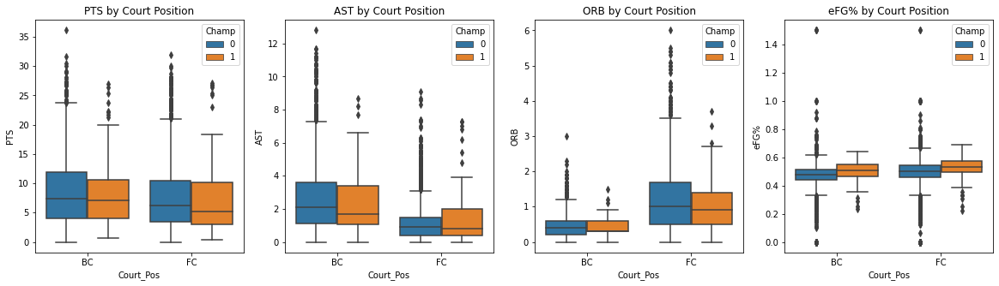

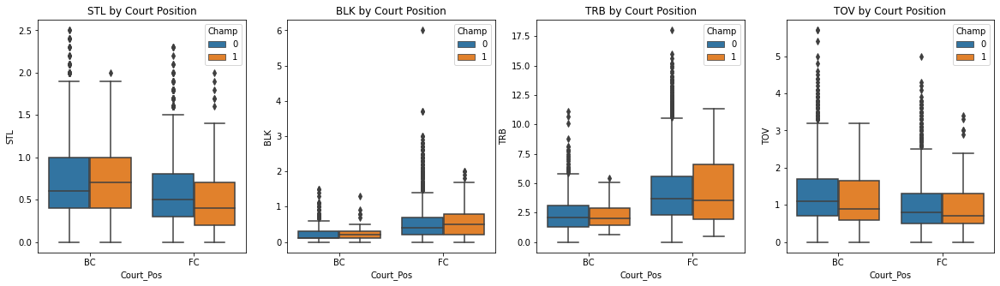

In [27]:
#box plots with court positions for each item in the features list grouped by the team
figA, (ax1, ax2, ax3,ax8) = plt.subplots(ncols=4, figsize=(20,5))
for feature, a in zip(measures[:-5][0:4], [ax1, ax2, ax3, ax8]):
    a.set_title(feature+' by Court Position')
    sns.boxplot(x='Court_Pos', y=feature, hue='Champ', data=team_groups, ax=a)
figB, (ax4, ax5, ax6, ax7) = plt.subplots(ncols=4, figsize=(20,5))
for feature, b in zip(measures[:-5][4:8], [ax4, ax5, ax6, ax7]):
    b.set_title(feature+' by Court Position')
    sns.boxplot(x='Court_Pos', y=feature, hue='Champ', data=team_groups, ax=b)
plt.show()

### Champions vs. The Field 
Outstanding differences can be observed in ***eFG%, assists, total rebounds, blocks***. Surprisingly, the field has the edge on offensive rebounds and from the earlier heatmap, they didn't correlate strongly with points and assists or turnovers. Note that ORB and TRB will be correlated by default because ORB are part of the TRB tally. They were also found to highly correlate with blocks (opportunity for an offensive rebound may occur if an initial shot is blocked) Given the above, the four features will be considered strongly in the resulting model. Additionally, strongly correlated values will be evaluated for principal component analysis to tighten up the feature selection.

Another interesting observation is that the field has a better PTS spread. This doesn't really tell us anything because seasons are different in that the points per game might be higher in one season (for all teams). It would be more useful to see how the champion and runner-up compare because you have to win four games (and winning means scoring more points), so **PTS** will be left in as a feature for consideration.

Our assumptions about positional strengths mostly hold. There is a chance small forwards who are considered front court players are tipping the scales as they have increasingly shot the basketball compared to their fellow front court members. A strong argument could be made to give them their own category, but we are leaving as is for now to see the changes over the years by position.

### Five Features over Time
Next, would like to graph the four features above (eFG%, assists, total rebounds, blocks) over time to see how they change by position

In [ ]:
#measures over time for finals teams in different positions
def measure_over_time(measure, df):
    fig = px.scatter(df, x=measure, y='Year', log_y=True, size=measure, color='Court_Pos',                              hover_name='Tm', height=300,
                    title = 'Finals ' + measure + ' by Position over Time')
    fig.show()

#measures
big_ones = ['PTS', 'eFG%', 'AST', 'TRB', 'BLK']

In [21]:
for measure in big_ones:
    measure_over_time(measure, df_player[df_player['Champ']==1])

As anticipated:
- Front court dominated eFG%, BLK, TRB - they play closer to the basket and are taller than back court players on average
- Back court dominated assists, but the overall number of assists increased in the last few years (more concentrated dots further along). Not one player is responsible, looks like a team effort that brings the total average up
- Back court players had higher scoring clusters and slightly edged out their back court teammates even though we see that in the last few years, front court players (most likely LeBron James, Kawhi Leonard, and Kevin Durant based on the team ***hover to see***) have had high finals averages
 
Next time on the NBA finals learning project, we see whether we can apply dimensionality reduction to streamline the variables for our models (which will also include normalizing the variables as they are not distributed as such)

## Coaches EDA

Aim is to see which features should be considered for the championship teams that are attributable to the coach. Most of the categorical features in this dataset are the same as those in the player data, so other than coaches, most of this exploratory analysis will focus on the numerical features.

In [29]:
df_coach.head()

,Coach,Team,F-Seasons,Car-Seasons,CR-G,CR-W,CR-L,FR-G,FR-W,FR-L,...,CP-L,FP-G,FP-W,FP-L,Car.P-G,Car.P-W,Car.P-L,Year,Champ,Runner-Up
0,Mike Woodson,ATL,6,6,82,53,29,492,206,286,...,7.0,29.0,11.0,18.0,29.0,11.0,18.0,2010,0,0
1,Doc Rivers,BOS,6,11,82,50,32,492,280,212,...,9.0,71.0,41.0,30.0,86.0,46.0,40.0,2010,0,1
2,Larry Brown,CHA,2,29,82,44,38,164,79,85,...,4.0,4.0,0.0,4.0,235.0,120.0,115.0,2010,0,0
3,Vinny Del Negro,CHI,2,2,82,41,41,164,82,82,...,4.0,12.0,4.0,8.0,12.0,4.0,8.0,2010,0,0
4,Mike Brown,CLE,5,5,82,61,21,410,272,138,...,5.0,71.0,42.0,29.0,71.0,42.0,29.0,2010,0,0


In [28]:
coach_num_features = ['F-Seasons', 'Car-Seasons', 'CR-G', 'CR-W', 'CR-L', 'FR-G', 'FR-W', 'FR-L', 'Car-G', 'Car-W', 'Car-L', 'Car-W%', 'CP-G', 'CP-W', 'CP-L', 'FP-G', 'FP-W', 'FP-L', 'Car.P-G', 'Car.P-W', 'Car.P-L']
coach_cat_features = ['Coach', 'Team', 'Year', 'Champ', 'Runner-Up']

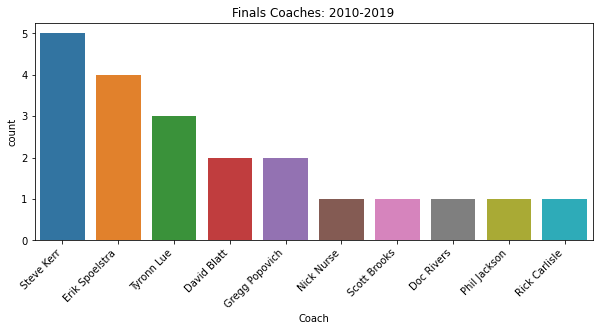

In [30]:
#categorical features; only coaching record is different from player table
def finals_coaches():
    fig, ax = plt.subplots(figsize=(10, 4))
    coached_finals = df_coach[(df_coach['Champ']==1) | (df_coach['Runner-Up']==1)]
    c1 = sns.countplot(x='Coach', data=coached_finals,
                    order=coached_finals['Coach'].value_counts().index)
    c1.set_xticklabels(c1.get_xticklabels(), rotation=45, horizontalalignment='right')
    c1.set_title('Finals Coaches: 2010-2019')
    plt.show()

finals_coaches()

From the above, we see Steve Kerr has appeared in the finals in the last half decade with the Golden State Warriors. 

**An issue to correct:** David Blatt did not win the championship with Cleveland even though he coached them the season they won with Ty Lue in 2016. This is going to be corrected for better representation of the last ten championship coaches (showing as 11 currently).

In [31]:
#preview change line to get index for Champ column change
df_coach[(df_coach['Coach']=='David Blatt') & (df_coach['Year']==2016)]

,Coach,Team,F-Seasons,Car-Seasons,CR-G,CR-W,CR-L,FR-G,FR-W,FR-L,...,CP-L,FP-G,FP-W,FP-L,Car.P-G,Car.P-W,Car.P-L,Year,Champ,Runner-Up
207,David Blatt,CLE,2,2,41,30,11,123,83,40,...,NaN,20.0,14.0,6.0,20.0,14.0,6.0,2016,1,0


In [32]:
#index 207 and item 'Champ' update
coaches.at[207, 'Champ'] = 0
#check/verify
coaches[(coaches['Coach']=='David Blatt') & (coaches['Year']==2016)]

,Coach,Team,F-Seasons,Car-Seasons,CR-G,CR-W,CR-L,FR-G,FR-W,FR-L,...,CP-L,FP-G,FP-W,FP-L,Car.P-G,Car.P-W,Car.P-L,Year,Champ,Runner-Up
207,David Blatt,CLE,2,2,41,30,11,123,83,40,...,NaN,20.0,14.0,6.0,20.0,14.0,6.0,2016,0,0


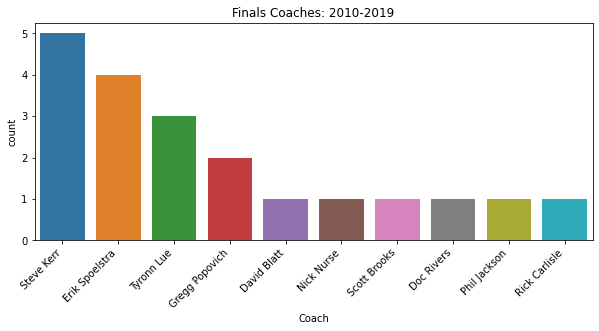

In [33]:
#resave the main dataset file
coaches.to_csv('coaches.csv')
#re-copy usage dataset and finals subsets
df_coach = coaches.copy()
coached_finals = df_coach[(df_coach['Champ']==1) | (df_coach['Runner-Up']==1)]

finals_coaches()

Now that the David Blatt line is fixed, the finals coaching data is reflective of coaches that won championships with their teams. Over the course of ten years, there were other mid-season firings that happened. These are not going to be tracked in this analysis (**for now**) for the following reasons:
- Unlike Ty Lue, none of them went on to win a championship that same season
- No metrics other than finals appearance is affected by this change
- The numerical features such us number of career games coached in the regular season and playoffs among others may be of importance for all coaches regardless of whether or not they were fired. Tracking fired status does not change the number of games they coached so tracking does not add much value for the purpose of this analysis.
- As always, this decision can be revisited if need be

In [34]:
#pivot data for coaches appearances, wins, losses
coach_appearances = coached_finals['Coach'].value_counts()
lost = coached_finals[coached_finals['Champ']==0]['Coach'].value_counts()
losses, wins = [], []
for coach in coach_appearances.index:
    if coach in lost.index: 
        losses.append(lost[coach])
        wins.append(coach_appearances[coach]-lost[coach])
    else:
        losses.append(0)
        wins.append(coach_appearances[coach])
data = {'Appearances': coach_appearances.values, 'Wins': wins, 'Losses': losses}
coach_results = pd.DataFrame(data=data, index=coach_appearances.index)
coach_results

,Appearances,Wins,Losses
Steve Kerr,5,3,2
Erik Spoelstra,4,2,2
Tyronn Lue,3,1,2
Gregg Popovich,2,1,1
David Blatt,1,0,1
Nick Nurse,1,1,0
Scott Brooks,1,0,1
Doc Rivers,1,0,1
Phil Jackson,1,1,0
Rick Carlisle,1,1,0


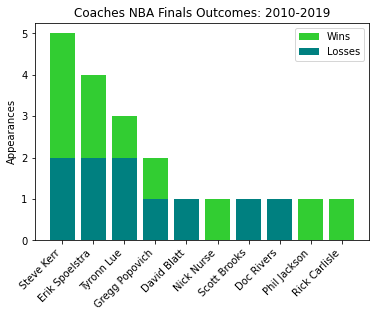

In [35]:
#we want a stacked bar graph of appearance to wins
#appearances bar graphs
fig, (ax1) = plt.subplots()
p1 = plt.bar(coach_results.index, height=coach_results['Losses'], color='teal')
p2 = plt.bar(coach_results.index, height=coach_results['Wins'], bottom=coach_results['Losses'],                  color='limegreen')
plt.xticks(rotation=45, horizontalalignment='right')
plt.title('Coaches NBA Finals Outcomes: 2010-2019')
plt.ylabel('Appearances')
plt.legend((p2[0], p1[0]), ('Wins', 'Losses'))
plt.show()